<a href="https://colab.research.google.com/github/shadab4150/Deep-Learning-Classifiers/blob/master/Liverpool_university_time_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))
  
# Then move kaggle.json into the folder where the API expects to find it.
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json


Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 68 bytes


In [4]:
!kaggle competitions download -c liverpool-ion-switching

  0% 0.00/4.27M [00:00<?, ?B/s]
100% 4.27M/4.27M [00:00<00:00, 70.4MB/s]
 50% 5.00M/9.91M [00:00<00:00, 47.5MB/s]
100% 9.91M/9.91M [00:00<00:00, 63.3MB/s]
 53% 14.0M/26.6M [00:00<00:00, 66.1MB/s]
100% 26.6M/26.6M [00:00<00:00, 87.7MB/s]


In [5]:
!unzip test.csv.zip 
!unzip train.csv.zip
!unzip sample_submission.csv.zip

Archive:  test.csv.zip
  inflating: test.csv                
Archive:  train.csv.zip
  inflating: train.csv               
Archive:  sample_submission.csv.zip
  inflating: sample_submission.csv   


In [0]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from fastai.tabular import *
import gc
from tqdm import tqdm,tnrange
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import os
from math import *
import random

# Any results you write to the current directory are saved as output.

In [0]:
df = pd.read_csv('train.csv')
ts = pd.read_csv('test.csv')

In [8]:
df.head()

,time,signal,open_channels
0,0.0001,-2.7600,0
1,0.0002,-2.8557,0
2,0.0003,-2.4074,0
3,0.0004,-3.1404,0
4,0.0005,-3.1525,0


In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000000 entries, 0 to 4999999
Data columns (total 4 columns):
time             float64
signal           float64
open_channels    int64
signal_log       float64
dtypes: float64(3), int64(1)
memory usage: 152.6 MB


In [9]:
ts.head()

,time,signal
0,500.0001,-2.6498
1,500.0002,-2.8494
2,500.0003,-2.8600
3,500.0004,-2.4350
4,500.0005,-2.6155


In [10]:
ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000000 entries, 0 to 1999999
Data columns (total 2 columns):
time      float64
signal    float64
dtypes: float64(2)
memory usage: 30.5 MB


# Channels distribution

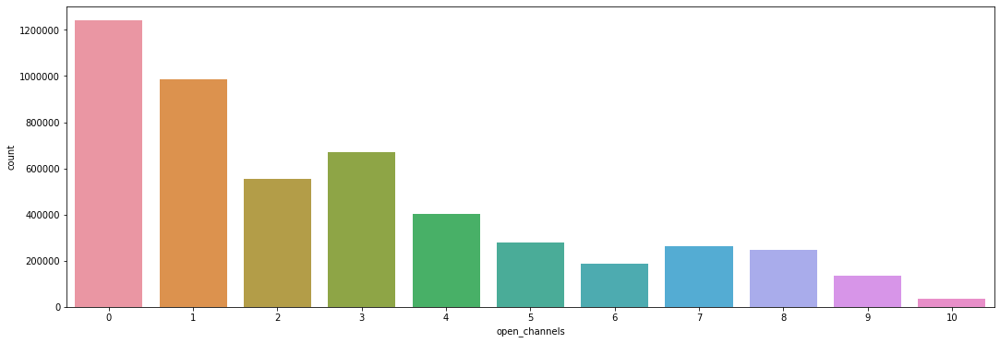

In [11]:
plt.figure(1,figsize=(18,6))
sns.countplot(df.open_channels);

In [0]:
ch = df.groupby(['open_channels'])

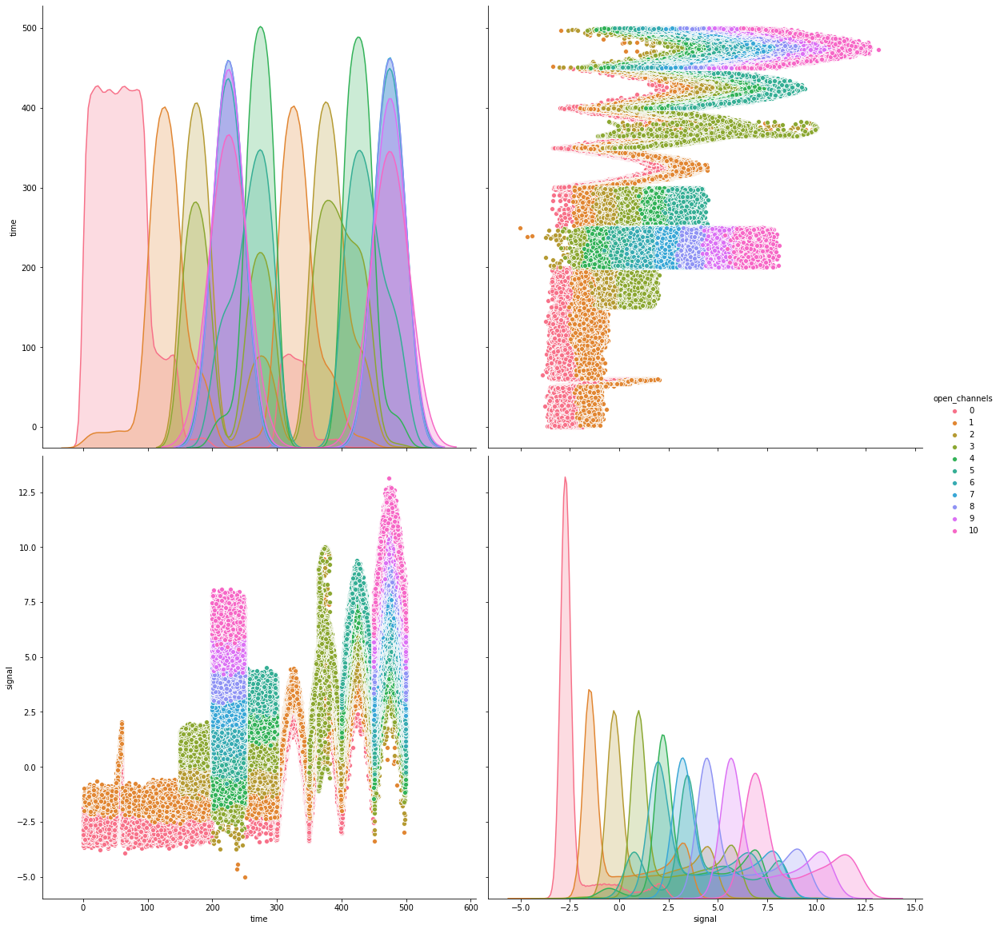

In [10]:
sns.pairplot(df.sample(frac=0.1,random_state=64),hue='open_channels',height=8)

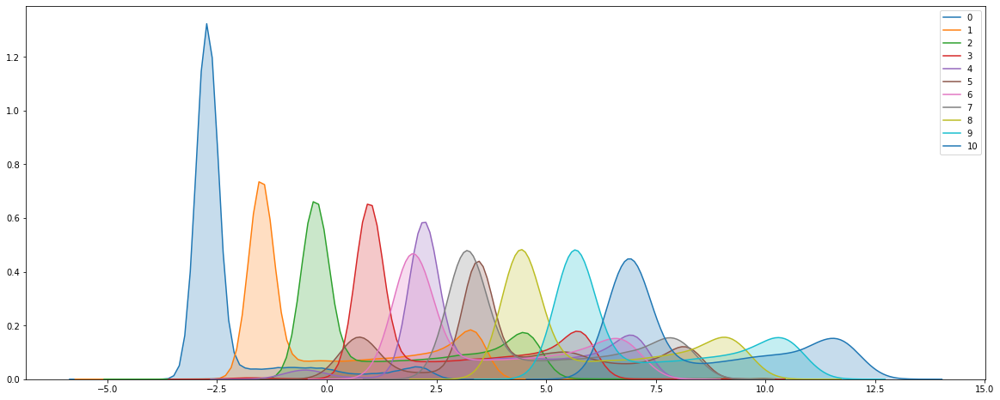

In [16]:
plt.figure(1,figsize=(20,8))
for i in range(11):
    sns.kdeplot(ch.get_group(i).signal,label=str(i),shade=True,legend=True)

In [0]:
from scipy.stats import rankdata 

In [0]:
df['rank'] = rankdata(df.signal.values)

In [0]:
df['signal_exp']=np.exp(df.signal.values)

In [0]:
df['sig_log']=np.log(np.array(df.signal.values)+10)

In [11]:
df.tail()

,time,signal,open_channels
4999995,499.9996,2.9194,7
4999996,499.9997,2.6980,7
4999997,499.9998,4.5164,8
4999998,499.9999,5.6397,9
4999999,500.0000,5.3792,9


In [64]:
df.head()

,time,signal,open_channels,frac_part,int_part
0,0.0001,-2.7600,0,-0.7600,-2.0
1,0.0002,-2.8557,0,-0.8557,-2.0
2,0.0003,-2.4074,0,-0.4074,-2.0
3,0.0004,-3.1404,0,-0.1404,-3.0
4,0.0005,-3.1525,0,-0.1525,-3.0


In [0]:
df['frac_part'] = [modf(x)[0] for x in np.array(df.signal.values)]
df['int_part'] = [modf(x)[1] for x in np.array(df.signal.values)]

In [66]:
ch_m=ch.mean()
ch_m.reset_index(inplace=True)
ch_m

,open_channels,time,signal,frac_part,int_part
0,0,89.824994,-2.261752,-0.500946,-1.760807
1,1,231.211255,0.045153,-0.112157,0.157310
2,2,291.448727,1.318063,0.096451,1.221612
3,3,308.694540,2.527458,0.503956,2.023503
4,4,349.830864,3.572789,0.436942,3.135847
5,5,350.406325,4.129024,0.485595,3.643429
6,6,351.473805,3.539624,0.502040,3.037584
7,7,350.157791,4.761342,0.495195,4.266147
8,8,349.574978,5.998460,0.495995,5.502466
9,9,347.395810,7.214782,0.503792,6.710990


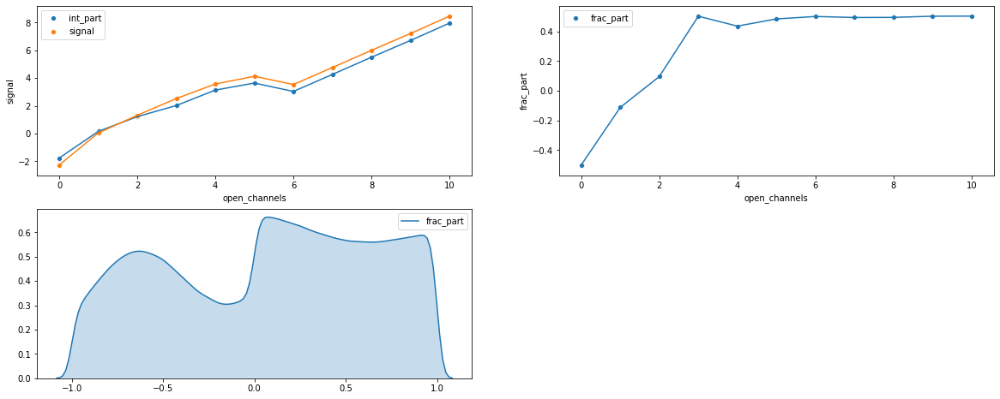

In [78]:
plt.figure(1,figsize=(20,8))
plt.subplot(221)
sns.lineplot(data=ch_m,x='open_channels',y='int_part')
sns.scatterplot(data=ch_m,x='open_channels',y='int_part',label='int_part')
sns.lineplot(data=ch_m,x='open_channels',y='signal',)
sns.scatterplot(data=ch_m,x='open_channels',y='signal',label='signal')
plt.subplot(222)
sns.lineplot(data=ch_m,x='open_channels',y='frac_part')
sns.scatterplot(data=ch_m,x='open_channels',y='frac_part',label='frac_part')
plt.subplot(223)
sns.kdeplot(df.frac_part,shade=True,label='frac_part');


In [82]:
px.scatter(df.sample(frac=0.1,random_state=42),x='time',y='signal',color='open_channels',trendline='ols')

In [79]:
px.line(ch.get_group(9)[:25000],x='time',y='signal',title='group_9',)

In [0]:
sns.set_style('darkgrid')

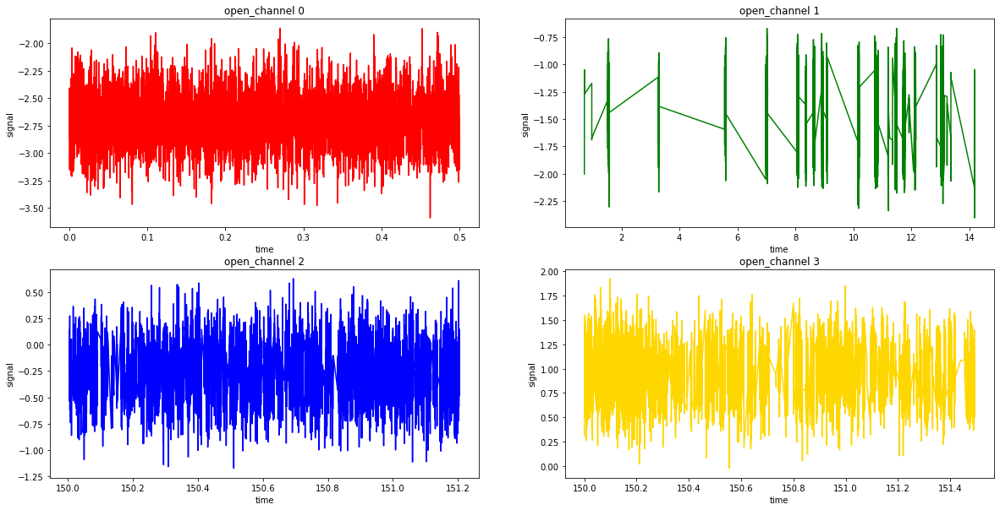

In [224]:
plt.figure(1,figsize=(20,10))
for i in range(4):
    plt.subplot(221+i)
    sns.lineplot(data=ch.get_group(i)[:5000],x='time',y='signal',color=color_list[i]);
    plt.title('open_channel '+str(i))

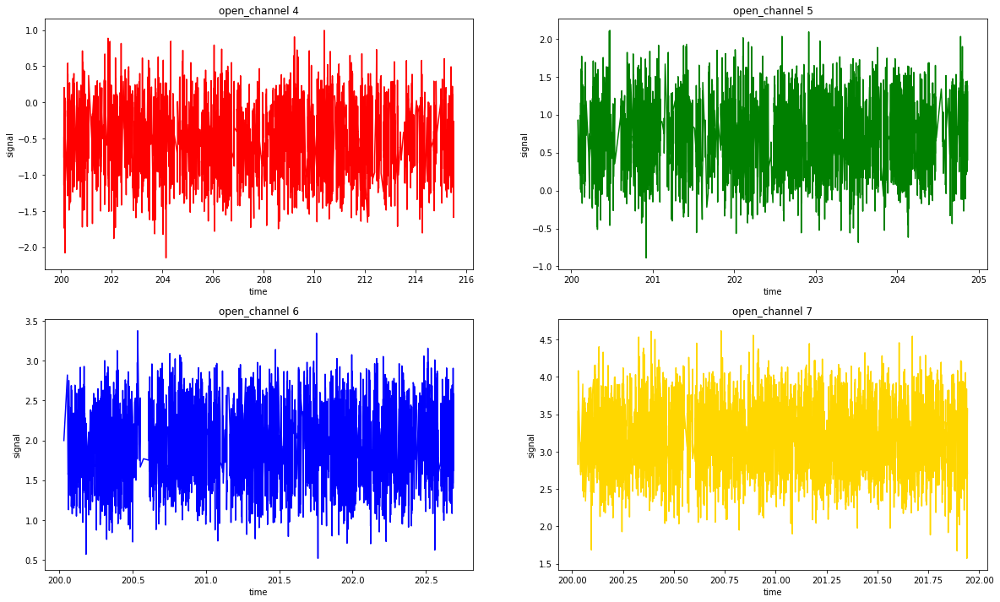

In [223]:
plt.figure(1,figsize=(20,12))
n=0
for i in range(4,8):
    plt.subplot(221+n)
    sns.lineplot(data=ch.get_group(i)[:5000],x='time',y='signal',color=color_list[i]);
    plt.title('open_channel '+str(i))
    n+=1

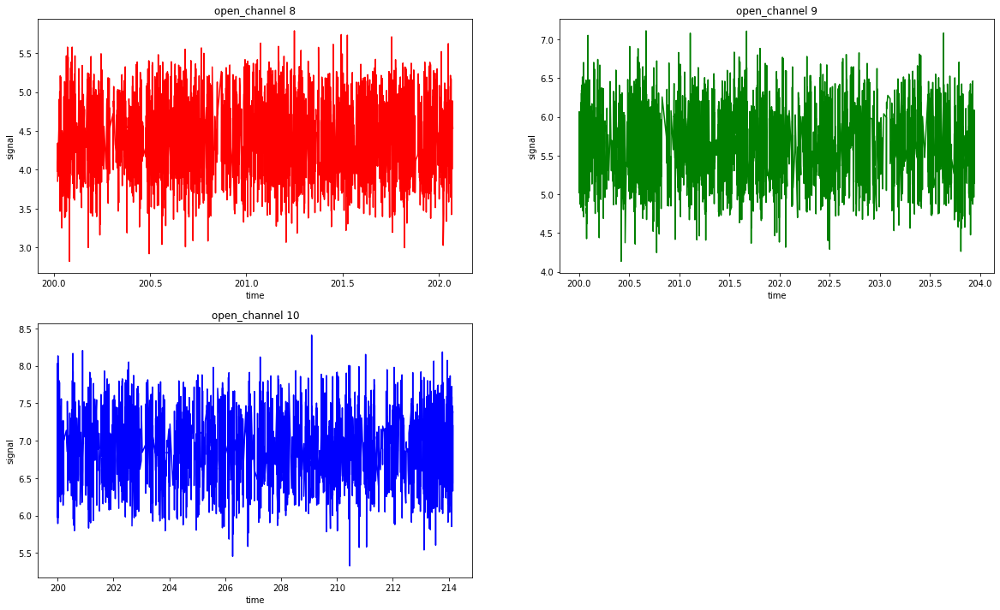

In [222]:
plt.figure(1,figsize=(20,12))
n=0
for i in range(8,11):
    plt.subplot(221+n)
    sns.lineplot(data=ch.get_group(i)[:5000],x='time',y='signal',color=color_list[i%8]);
    plt.title('open_channel '+str(i))
    n+=1

In [225]:
fig = go.Figure(data=[go.Scatter(x=df.iloc[100000:125000]['time'], y=df.iloc[100000:125000]['signal'], name='Signal'),])

fig.update_layout(title='Signal (part of batch #0)')
fig.show()

# Rolling mean of window sizes [10,50,100,1000]

In [0]:
window_sizes = [10, 50, 100, 1000]
for window in window_sizes:
    df["rolling_mean_" + str(window)] = df['signal'].rolling(window=window).mean()
    df["rolling_std_" + str(window)] = df['signal'].rolling(window=window).std()

In [0]:
mean_df = df.iloc[2200000:2210000]

In [194]:
df.iloc[200000:200003]

,time,signal,open_channels,frac_part,int_part,rolling_mean_10,rolling_std_10,rolling_mean_50,rolling_std_50,rolling_mean_100,rolling_std_100,rolling_mean_1000,rolling_std_1000
200000,20.0001,-2.6012,0,-0.6012,-2.0,-2.88740,0.309814,-2.765296,0.277686,-2.764524,0.248843,-2.729727,0.250008
200001,20.0002,-2.7228,0,-0.7228,-2.0,-2.87631,0.313907,-2.758664,0.274582,-2.763738,0.248850,-2.729526,0.249933
200002,20.0003,-2.6274,0,-0.6274,-2.0,-2.80609,0.277692,-2.753082,0.274353,-2.756844,0.242851,-2.729381,0.249950


In [138]:
df.columns

Index(['time', 'signal', 'open_channels', 'frac_part', 'int_part',
       'rolling_mean_10', 'rolling_std_10', 'rolling_mean_50',
       'rolling_std_50', 'rolling_mean_100', 'rolling_std_100',
       'rolling_mean_1000', 'rolling_std_1000'],
      dtype='object')

# channels distribution per batch

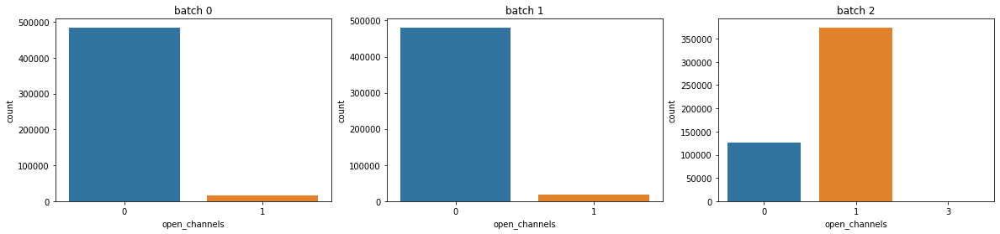

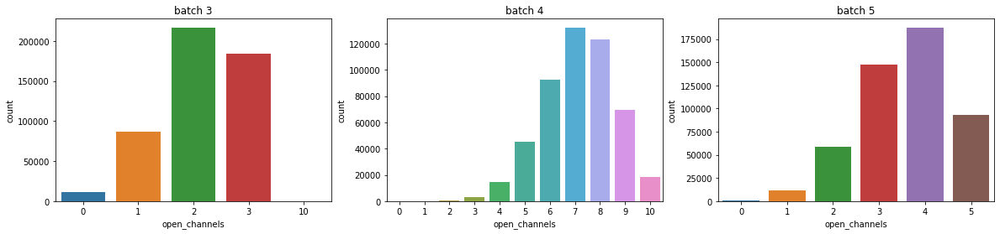

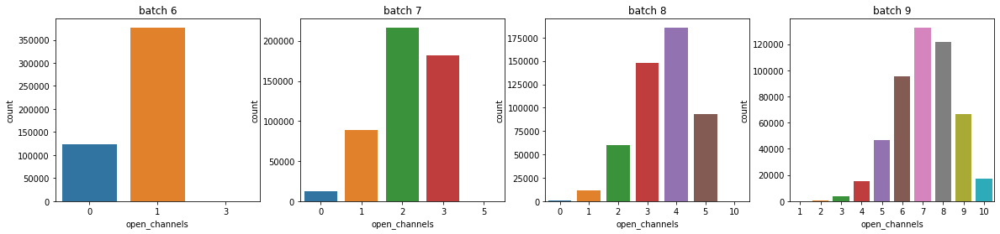

In [190]:
plt.figure(1,figsize=(20,4))
n=0
for i in range(3):
  plt.subplot(131+n)
  data = df.iloc[(i * 500000):((i+1) * 500000 + 1)]
  sns.countplot(x=data.open_channels)
  plt.title('batch '+str(i))
  n+=1
plt.show()
plt.figure(2,figsize=(20,4))
n=0
for i in range(3,6):
  plt.subplot(131+n)
  data = df.iloc[(i * 500000):((i+1) * 500000 + 1)]
  sns.countplot(x=data.open_channels)
  plt.title('batch '+str(i))
  n+=1
plt.show()
plt.figure(3,figsize=(20,4))
n=0
for i in range(6,10):
  plt.subplot(141+n)
  data = df.iloc[(i * 500000):((i+1) * 500000 + 1)]
  sns.countplot(x=data.open_channels)
  plt.title('batch '+str(i))
  n+=1
plt.show()
  


In [0]:
col = ['rolling_mean_10', 'rolling_std_10', 'rolling_mean_50',
       'rolling_std_50', 'rolling_mean_100', 'rolling_std_100',
       'rolling_mean_1000', 'rolling_std_1000']

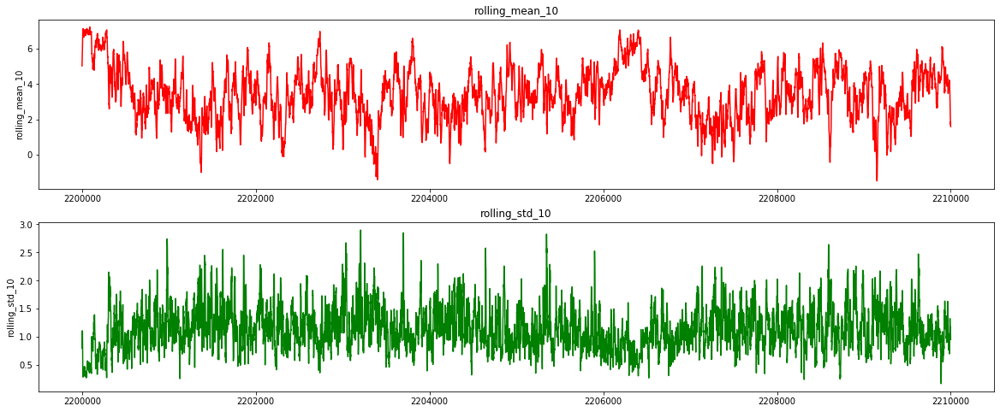

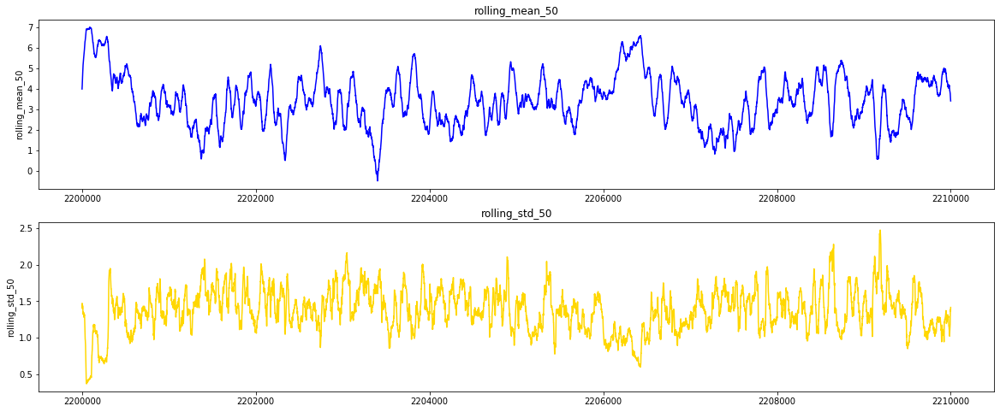

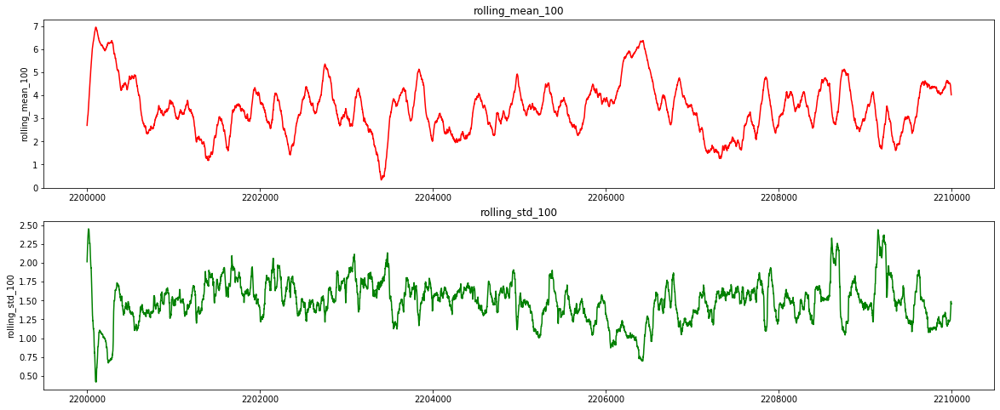

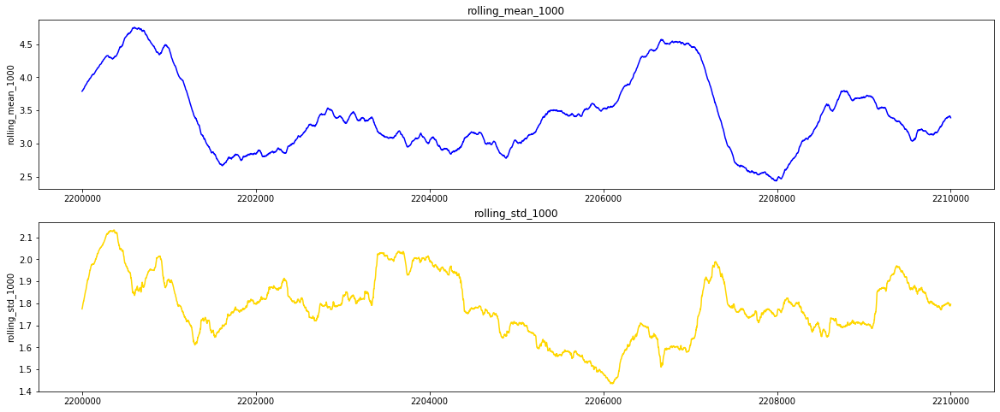

In [170]:
color_list= ['red','green','blue','gold','red','green','blue','gold']
for i in range(0,len(col),2):
  plt.figure(1,figsize=(20,8))
  plt.subplot(211)
  sns.lineplot(y=mean_df[col[i]],x=list(range(2200000,2210000)),color=color_list[i])
  plt.title(col[i])
  plt.subplot(212)
  sns.lineplot(y=mean_df[col[i+1]],x=list(range(2200000,2210000)),color=color_list[i+1])
  plt.title(col[i+1])
  plt.show()

In [0]:
procs=[FillMissing, Categorify, Normalize]

In [0]:
path = Path('/kaggle/working/')

In [0]:
ts.shape[0],df.shape[0]

In [0]:
df.shape

In [0]:
data = (TabularList.from_df(df.sample(frac=0.15,random_state=64), path=path, cat_names=None, cont_names=['time','signal','frac_part'], procs=procs,)
                .split_by_rand_pct(0.1)
                .label_from_df(cols='open_channels')
                
                .databunch())

In [103]:
df.sample(frac=0.15,random_state=64,)

,time,signal,open_channels,frac_part,int_part
3627316,362.7317,4.2737,3,0.2737,4.0
813922,81.3923,-2.6392,0,-0.6392,-2.0
2033535,203.3536,4.1757,8,0.1757,4.0
1454830,145.4831,-1.0745,1,-0.0745,-1.0
4668869,466.8870,10.1950,9,0.1950,10.0
...,...,...,...,...,...
1169887,116.9888,-1.4252,1,-0.4252,-1.0
2579250,257.9251,3.8287,5,0.8287,3.0
437338,43.7339,-2.2615,0,-0.2615,-2.0
136382,13.6383,-2.6990,0,-0.6990,-2.0


In [87]:
data.show_batch()

time,signal,frac_part,target
-1.4506,-1.3075,-1.8590,0
-1.0446,-1.3044,-1.8408,0
-0.1834,-0.1181,1.5986,5
-0.4171,-0.5132,-0.7158,2
-0.6127,-0.4656,-0.4370,2


In [234]:
data.classes

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

In [0]:
fb = FBeta()
fb.average = 'macro'
kappa = KappaScore()
kappa.weights = "quadratic"

In [0]:
learn = tabular_learner(data, layers=[500,300], ps=[0.001,0.01], emb_drop=0.04,metrics=[kappa,fb]) 


In [261]:
learn.model

TabularModel(
  (embeds): ModuleList()
  (emb_drop): Dropout(p=0.04, inplace=False)
  (bn_cont): BatchNorm1d(3, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (layers): Sequential(
    (0): Linear(in_features=3, out_features=500, bias=True)
    (1): ReLU(inplace=True)
    (2): BatchNorm1d(500, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.001, inplace=False)
    (4): Linear(in_features=500, out_features=300, bias=True)
    (5): ReLU(inplace=True)
    (6): BatchNorm1d(300, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout(p=0.01, inplace=False)
    (8): Linear(in_features=300, out_features=11, bias=True)
  )
)

In [262]:
learn.summary()

TabularModel
Layer (type)         Output Shape         Param #    Trainable 
BatchNorm1d          [3]                  6          True      
______________________________________________________________________
Linear               [500]                2,000      True      
______________________________________________________________________
ReLU                 [500]                0          False     
______________________________________________________________________
BatchNorm1d          [500]                1,000      True      
______________________________________________________________________
Dropout              [500]                0          False     
______________________________________________________________________
Linear               [300]                150,300    True      
______________________________________________________________________
ReLU                 [300]                0          False     
_________________________________________________

epoch,train_loss,valid_loss,kappa_score,f_beta,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


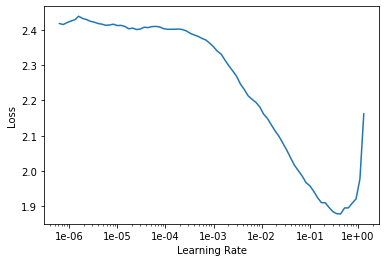

In [258]:
learn.lr_find()
learn.recorder.plot()

In [0]:
#np.linspace(1e-3,1e-2,5)

In [92]:
learn.fit_one_cycle(2,1e-2,wd=0.2)

epoch,train_loss,valid_loss,kappa_score,f_beta,time
0,0.925449,0.902635,0.938037,0.520383,02:17
1,0.721233,0.581279,0.969803,0.684830,02:22


In [93]:
interp = ClassificationInterpretation.from_learner(learn)

In [95]:
interp.plot_tab_top_losses(k=12)

,Prediction,Actual,Loss,Probability,time,signal,frac_part
0,0,1,17.83,0.00,-0.0819,-1.8117,-1.3025
1,0,1,16.49,0.00,-0.0713,-1.7426,-0.8977
2,0,2,10.01,0.00,-0.2972,-1.5269,-1.3889
3,0,2,8.87,0.00,-0.1100,-1.3752,-0.5007
4,0,2,8.83,0.00,-0.3396,-1.4393,-0.8759
5,0,2,8.49,0.00,-0.3305,-1.4135,-0.7248
6,10,2,6.39,0.00,0.8606,2.5783,1.5986
7,10,2,6.30,0.00,0.8715,2.5794,1.6051
8,10,2,6.29,0.00,0.8496,2.5623,1.5047
9,10,2,6.28,0.00,0.8494,2.5619,1.5026


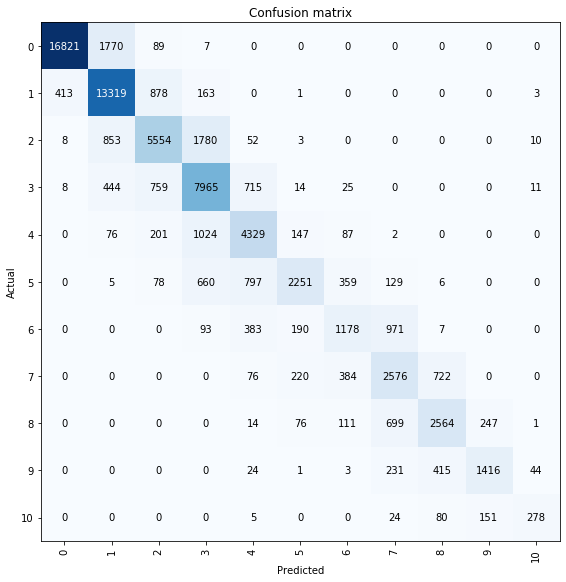

In [98]:
interp.plot_confusion_matrix(figsize=(18,8))

epoch,train_loss,valid_loss,kappa_score,f_beta,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


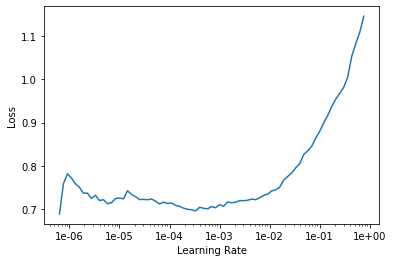

In [116]:
learn.lr_find()
learn.recorder.plot()

In [123]:
np.linspace(1e-5,1e-4,5)

array([1.00e-05, 3.25e-05, 5.50e-05, 7.75e-05, 1.00e-04])

In [124]:
learn.fit_one_cycle(2,5.50e-05,wd=0.3)

epoch,train_loss,valid_loss,kappa_score,f_beta,time
0,0.693234,0.588698,0.968579,0.690310,02:28
1,0.721868,0.586295,0.970537,0.689848,02:30
